# Importing libaries

In [2]:
import pandas as pd
import numpy as  np

import seaborn as sns
import matplotlib.pyplot as plt
from plotly.subplots import make_subplots
import plotly.graph_objects as go

from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_validate
from sklearn.model_selection import GridSearchCV

from sklearn.metrics import r2_score
from sklearn.metrics import mean_squared_error
from sklearn.metrics import mean_absolute_error

from sklearn.ensemble import ExtraTreesRegressor

import pickle

import pycaret
from pycaret.regression import *

# First look at the dataset

## General overlook

In [2]:
sales_df = pd.read_csv('../Datasets/car_price_prediction-preprocess.csv')
print(sales_df.shape)
sales_df.head()

(18924, 18)


,price,levy,manufacturer,model,production_year,category,lether_interior,fuel_type,engine_size,mileage,cylinders,gearbox_type,drive_wheels,doors,wheel,color,airbags,turbo
0,13328,1399,LEXUS,RX 450,2010,Jeep,Yes,Hybrid,3.5,186005,6,Automatic,4x4,4,Left wheel,Silver,12,0
1,16621,1018,CHEVROLET,Equinox,2011,Jeep,No,Petrol,3.0,192000,6,Tiptronic,4x4,4,Left wheel,Black,8,0
2,8467,0,HONDA,FIT,2006,Hatchback,No,Petrol,1.3,200000,4,Variator,Front,4,Right-hand drive,Black,2,0
3,3607,862,FORD,Escape,2011,Jeep,Yes,Hybrid,2.5,168966,4,Automatic,4x4,4,Left wheel,White,0,0
4,11726,446,HONDA,FIT,2014,Hatchback,Yes,Petrol,1.3,91901,4,Automatic,Front,4,Left wheel,Silver,4,0


In [3]:
sales_df.describe()

,price,levy,production_year,engine_size,mileage,cylinders,doors,airbags,turbo
count,1.892400e+04,18924.000000,18924.000000,18924.000000,1.892400e+04,18924.000000,18924.000000,18924.000000,18924.000000
mean,1.858744e+04,632.886493,2010.914236,2.306251,1.555373e+06,4.580216,3.925386,6.568379,0.099979
std,1.921356e+05,568.273736,5.665749,0.877591,4.880221e+07,1.200223,0.404138,4.322323,0.299980
min,1.000000e+00,0.000000,1939.000000,0.000000,0.000000e+00,1.000000,2.000000,0.000000,0.000000
25%,5.331000e+03,0.000000,2009.000000,1.800000,7.019575e+04,4.000000,4.000000,4.000000,0.000000
50%,1.317200e+04,642.000000,2012.000000,2.000000,1.264000e+05,4.000000,4.000000,6.000000,0.000000
75%,2.206300e+04,917.000000,2015.000000,2.500000,1.891198e+05,4.000000,4.000000,12.000000,0.000000
max,2.630750e+07,11714.000000,2020.000000,20.000000,2.147484e+09,16.000000,5.000000,16.000000,1.000000


In [4]:
sales_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 18924 entries, 0 to 18923
Data columns (total 18 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   price            18924 non-null  int64  
 1   levy             18924 non-null  int64  
 2   manufacturer     18924 non-null  object 
 3   model            18924 non-null  object 
 4   production_year  18924 non-null  int64  
 5   category         18924 non-null  object 
 6   lether_interior  18924 non-null  object 
 7   fuel_type        18924 non-null  object 
 8   engine_size      18924 non-null  float64
 9   mileage          18924 non-null  int64  
 10  cylinders        18924 non-null  int64  
 11  gearbox_type     18924 non-null  object 
 12  drive_wheels     18924 non-null  object 
 13  doors            18924 non-null  int64  
 14  wheel            18924 non-null  object 
 15  color            18924 non-null  object 
 16  airbags          18924 non-null  int64  
 17  turbo       

## Looking at the outliers and data distribution

In [5]:
sales_df_numerical = sales_df.select_dtypes(include='number')
fig = make_subplots(rows = len(sales_df_numerical.columns) + 1, cols = 2)
colors = ['blue', 'green', 'red', 'orange', 'purple']

for i, column in enumerate(sales_df_numerical.columns):
    color_index = i % len(colors) 
    color = colors[color_index]
    fig.add_trace(go.Histogram(x=sales_df_numerical[column], name=column, marker_color=color), row=i + 1, col = 1)
    fig.add_trace(go.Box(x=sales_df_numerical[column], name=column, marker_color=color), row=i + 1, col = 2)

fig.update_layout(height=800, width=1000)
fig.show()

In [6]:
#Removing outliers from the first observations
sales_df = sales_df[sales_df['price'] < 250000]
sales_df = sales_df[sales_df['levy'] < 2500]
sales_df = sales_df[sales_df['mileage'] < 200000]
sales_df.head()

,price,levy,manufacturer,model,production_year,category,lether_interior,fuel_type,engine_size,mileage,cylinders,gearbox_type,drive_wheels,doors,wheel,color,airbags,turbo
0,13328,1399,LEXUS,RX 450,2010,Jeep,Yes,Hybrid,3.5,186005,6,Automatic,4x4,4,Left wheel,Silver,12,0
1,16621,1018,CHEVROLET,Equinox,2011,Jeep,No,Petrol,3.0,192000,6,Tiptronic,4x4,4,Left wheel,Black,8,0
3,3607,862,FORD,Escape,2011,Jeep,Yes,Hybrid,2.5,168966,4,Automatic,4x4,4,Left wheel,White,0,0
4,11726,446,HONDA,FIT,2014,Hatchback,Yes,Petrol,1.3,91901,4,Automatic,Front,4,Left wheel,Silver,4,0
5,39493,891,HYUNDAI,Santa FE,2016,Jeep,Yes,Diesel,2.0,160931,4,Automatic,Front,4,Left wheel,White,4,0


# First encoding
As some of the rows are categorical, we will convert them to numbers via a label encoding technic

## Encoding manufacturer and model

In [7]:
manufacturer_dict = {manufacturer: i for i, manufacturer in enumerate(sales_df['manufacturer'].unique())}
sales_df['manufacturer'] = sales_df['manufacturer'].map(manufacturer_dict)
model_dict = {model: i for i, model in enumerate(sales_df['model'].unique())}
sales_df['model'] = sales_df['model'].map(model_dict)
sales_df.head()

,price,levy,manufacturer,model,production_year,category,lether_interior,fuel_type,engine_size,mileage,cylinders,gearbox_type,drive_wheels,doors,wheel,color,airbags,turbo
0,13328,1399,0,0,2010,Jeep,Yes,Hybrid,3.5,186005,6,Automatic,4x4,4,Left wheel,Silver,12,0
1,16621,1018,1,1,2011,Jeep,No,Petrol,3.0,192000,6,Tiptronic,4x4,4,Left wheel,Black,8,0
3,3607,862,2,2,2011,Jeep,Yes,Hybrid,2.5,168966,4,Automatic,4x4,4,Left wheel,White,0,0
4,11726,446,3,3,2014,Hatchback,Yes,Petrol,1.3,91901,4,Automatic,Front,4,Left wheel,Silver,4,0
5,39493,891,4,4,2016,Jeep,Yes,Diesel,2.0,160931,4,Automatic,Front,4,Left wheel,White,4,0


## First ML model
We run Pycaret in the first notebook (AKA data cleaning) and get a score of about 0.5.
We are still at a early stage of the developement, but let's see if we get any improvement

In [8]:
def ml_testing():
    from pycaret.regression import RegressionExperiment
    s = RegressionExperiment()
    s.setup(sales_df, target = 'price', session_id = 1)
    best = s.compare_models()
    return best

In [9]:
ml_testing()

,Description,Value
0,Session id,1
1,Target,price
2,Target type,Regression
3,Original data shape,"(14674, 18)"
4,Transformed data shape,"(14674, 53)"
5,Transformed train set shape,"(10271, 53)"
6,Transformed test set shape,"(4403, 53)"
7,Ordinal features,2
8,Numeric features,10
9,Categorical features,7


,Model,MAE,MSE,RMSE,R2,RMSLE,MAPE,TT (Sec)
rf,Random Forest Regressor,4832.1569,94240280.9108,9640.2192,0.7232,1.0585,12.9122,6.6270
et,Extra Trees Regressor,4841.3561,98488756.8009,9865.5237,0.7108,1.0336,11.5824,5.3110
lightgbm,Light Gradient Boosting Machine,5595.8474,98267806.1058,9868.8704,0.7101,1.2257,13.9411,0.8180
xgboost,Extreme Gradient Boosting,5404.7352,100041761.6539,9963.9084,0.7048,1.1665,13.5514,0.8660
gbr,Gradient Boosting Regressor,7214.2675,138428111.7145,11722.3225,0.5918,1.3678,16.1297,2.1770
dt,Decision Tree Regressor,6223.0570,166974920.6473,12854.8821,0.5065,1.3436,12.4278,0.3920
br,Bayesian Ridge,10360.6409,235510567.6478,15315.1743,0.3023,1.5696,17.8764,0.4960
ridge,Ridge Regression,10374.3879,235702799.4964,15321.5144,0.3017,1.5725,17.8485,0.2730
llar,Lasso Least Angle Regression,10373.4889,235730189.9186,15322.3540,0.3016,1.5691,17.8703,0.4760
lasso,Lasso Regression,10373.5821,235738205.6390,15322.6070,0.3016,1.5692,17.8702,0.7240


RandomForestRegressor(n_jobs=-1, random_state=1)

Results are already better, but let's try to go further by encoding all the other categorical columns

# Further encoding

## Encoding the remaining categorical columns

In [10]:
sales_df['lether_interior'] = sales_df['lether_interior'].replace({'Yes': 1, 'No': 0})

In [11]:
fuel_type_dict = {fuel_type: i for i, fuel_type in enumerate(sales_df['fuel_type'].unique())}
sales_df['fuel_type'] = sales_df['fuel_type'].map(fuel_type_dict)

In [12]:
gearbox_type_dict = {gearbox_type: i for i, gearbox_type in enumerate(sales_df['gearbox_type'].unique())}
sales_df['gearbox_type'] = sales_df['gearbox_type'].map(gearbox_type_dict)

In [13]:
drive_wheels_dict = {drive_wheels: i for i, drive_wheels in enumerate(sales_df['drive_wheels'].unique())}
sales_df['drive_wheels'] = sales_df['drive_wheels'].map(drive_wheels_dict)

In [14]:
color_dict = {color: i for i, color in enumerate(sales_df['color'].unique())}
sales_df['color'] = sales_df['color'].map(color_dict)

In [15]:
category_dict = {category: i for i, category in enumerate(sales_df['category'].unique())}
sales_df['category'] = sales_df['category'].map(category_dict)

In [16]:
wheel_dict = {wheel: i for i, wheel in enumerate(sales_df['wheel'].unique())}
sales_df['wheel'] = sales_df['wheel'].map(wheel_dict)

In [17]:
sales_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 14674 entries, 0 to 18923
Data columns (total 18 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   price            14674 non-null  int64  
 1   levy             14674 non-null  int64  
 2   manufacturer     14674 non-null  int64  
 3   model            14674 non-null  int64  
 4   production_year  14674 non-null  int64  
 5   category         14674 non-null  int64  
 6   lether_interior  14674 non-null  int64  
 7   fuel_type        14674 non-null  int64  
 8   engine_size      14674 non-null  float64
 9   mileage          14674 non-null  int64  
 10  cylinders        14674 non-null  int64  
 11  gearbox_type     14674 non-null  int64  
 12  drive_wheels     14674 non-null  int64  
 13  doors            14674 non-null  int64  
 14  wheel            14674 non-null  int64  
 15  color            14674 non-null  int64  
 16  airbags          14674 non-null  int64  
 17  turbo       

All columns have been change to numerical and we do not have any nans. Let's see if we can obtain a better score

## Second ML model

In [18]:
ml_testing()

,Description,Value
0,Session id,1
1,Target,price
2,Target type,Regression
3,Original data shape,"(14674, 18)"
4,Transformed data shape,"(14674, 18)"
5,Transformed train set shape,"(10271, 18)"
6,Transformed test set shape,"(4403, 18)"
7,Numeric features,17
8,Preprocess,True
9,Imputation type,simple


,Model,MAE,MSE,RMSE,R2,RMSLE,MAPE,TT (Sec)
et,Extra Trees Regressor,4673.2571,93511904.3312,9620.6063,0.7248,1.0280,13.2004,2.8190
rf,Random Forest Regressor,4842.4736,95634651.7305,9737.5004,0.7181,1.0647,12.8841,4.5730
xgboost,Extreme Gradient Boosting,5358.0364,97284889.7923,9811.8189,0.7137,1.1576,13.1078,0.4170
lightgbm,Light Gradient Boosting Machine,5611.8232,99005937.6119,9910.2397,0.7078,1.2226,14.2182,0.5000
gbr,Gradient Boosting Regressor,7147.3352,135465598.0964,11591.7390,0.6009,1.3671,17.1605,1.9950
dt,Decision Tree Regressor,6286.7838,180605655.9855,13352.1501,0.4668,1.3361,12.9355,0.1050
ridge,Ridge Regression,11041.5824,260080030.7471,16099.1901,0.2288,1.5971,18.9119,0.0380
br,Bayesian Ridge,11031.2874,260080550.8428,16099.0754,0.2288,1.6004,18.9185,0.0670
llar,Lasso Least Angle Regression,11041.3308,260077212.3759,16099.1037,0.2288,1.5971,18.9133,0.0440
lasso,Lasso Regression,11041.3308,260077212.3670,16099.1037,0.2288,1.5971,18.9133,0.0620


ExtraTreesRegressor(n_jobs=-1, random_state=1)

It still not really better yet. We will have another look at the outlier

# More cleaning

## Removing more outliers

In [19]:
fig = make_subplots(rows = len(sales_df.columns) + 1, cols = 2)
colors = ['blue', 'green', 'red', 'orange', 'purple']

for i, column in enumerate(sales_df.columns):
    color_index = i % len(colors) 
    color = colors[color_index]
    fig.add_trace(go.Histogram(x=sales_df[column], name=column, marker_color=color), row=i + 1, col=1)
    fig.add_trace(go.Box(x=sales_df[column], name=column, marker_color=color), row=i + 1, col = 2)

fig.update_layout(height=1500, width=1000)
fig.show()

In [20]:
sales_df = sales_df[sales_df['price'] < 100000] #trying to keep a larger marker
sales_df = sales_df[sales_df['production_year'] > 1985] # Not that much cars sold before this date
sales_df = sales_df.drop(['turbo', 'wheel', 'cylinders'], axis = 1) #Almost all cars do not have turbo; we suppose we drive on the same side; cylinders and engine size are correlated
sales_df.head()

,price,levy,manufacturer,model,production_year,category,lether_interior,fuel_type,engine_size,mileage,gearbox_type,drive_wheels,doors,color,airbags
0,13328,1399,0,0,2010,0,1,0,3.5,186005,0,0,4,0,12
1,16621,1018,1,1,2011,0,0,1,3.0,192000,1,0,4,1,8
3,3607,862,2,2,2011,0,1,0,2.5,168966,0,0,4,2,0
4,11726,446,3,3,2014,1,1,1,1.3,91901,0,1,4,0,4
5,39493,891,4,4,2016,0,1,2,2.0,160931,0,1,4,2,4


## Machine learning testing and further

In [21]:
ml_testing()

,Description,Value
0,Session id,1
1,Target,price
2,Target type,Regression
3,Original data shape,"(14549, 15)"
4,Transformed data shape,"(14549, 15)"
5,Transformed train set shape,"(10184, 15)"
6,Transformed test set shape,"(4365, 15)"
7,Numeric features,14
8,Preprocess,True
9,Imputation type,simple


,Model,MAE,MSE,RMSE,R2,RMSLE,MAPE,TT (Sec)
et,Extra Trees Regressor,4293.1895,61187044.8240,7799.9703,0.7626,1.0378,12.4396,2.1080
rf,Random Forest Regressor,4464.0917,62500328.9612,7874.3018,0.7579,1.0667,11.7566,3.5930
lightgbm,Light Gradient Boosting Machine,5106.6674,66273662.7720,8124.8615,0.7426,1.2200,13.7153,0.4080
xgboost,Extreme Gradient Boosting,4979.1009,66698327.5222,8145.3501,0.7411,1.1670,13.8605,0.3000
gbr,Gradient Boosting Regressor,6752.4106,97115549.7655,9839.7285,0.6231,1.3706,15.0827,1.2010
dt,Decision Tree Regressor,5809.5552,117412449.5410,10808.6089,0.5437,1.3453,10.9097,0.1290
ada,AdaBoost Regressor,10558.0289,187580196.8212,13689.8425,0.2686,1.6740,24.5395,0.4760
br,Bayesian Ridge,10388.9906,199214192.0319,14108.0627,0.2249,1.6079,19.3201,0.0550
ridge,Ridge Regression,10393.8058,199215531.7674,14108.1893,0.2248,1.6080,19.2930,0.0630
llar,Lasso Least Angle Regression,10393.5832,199215655.0191,14108.1903,0.2248,1.6084,19.2943,0.0580


ExtraTreesRegressor(n_jobs=-1, random_state=1)

We haven't improve much the model. Let's see if we can remove more outliers

In [22]:
fig = make_subplots(rows = len(sales_df.columns) + 1, cols = 2)
colors = ['blue', 'green', 'red', 'orange', 'purple']

for i, column in enumerate(sales_df.columns):
    color_index = i % len(colors) 
    color = colors[color_index]
    fig.add_trace(go.Histogram(x=sales_df[column], name=column, marker_color=color), row=i + 1, col=1)
    fig.add_trace(go.Box(x=sales_df[column], name=column, marker_color=color), row=i + 1, col = 2)

fig.update_layout(height=1500, width=1000)
fig.show()

In [23]:
sales_df = sales_df[sales_df['price'] < 50000] #Prices above are outlier, and maybe a collectionneur market or something else
sales_df = sales_df[sales_df['levy'] < 2000] # levy above 2000 is considered outlier
sales_df = sales_df[sales_df['production_year'] > 2000] # It apprears that cars on sale are not really older than this date
sales_df = sales_df[sales_df['engine_size'] >= 1] # There is few car with this small engine
sales_df.head()

,price,levy,manufacturer,model,production_year,category,lether_interior,fuel_type,engine_size,mileage,gearbox_type,drive_wheels,doors,color,airbags
0,13328,1399,0,0,2010,0,1,0,3.5,186005,0,0,4,0,12
1,16621,1018,1,1,2011,0,0,1,3.0,192000,1,0,4,1,8
3,3607,862,2,2,2011,0,1,0,2.5,168966,0,0,4,2,0
4,11726,446,3,3,2014,1,1,1,1.3,91901,0,1,4,0,4
5,39493,891,4,4,2016,0,1,2,2.0,160931,0,1,4,2,4


In [24]:
ml_testing()

,Description,Value
0,Session id,1
1,Target,price
2,Target type,Regression
3,Original data shape,"(12999, 15)"
4,Transformed data shape,"(12999, 15)"
5,Transformed train set shape,"(9099, 15)"
6,Transformed test set shape,"(3900, 15)"
7,Numeric features,14
8,Preprocess,True
9,Imputation type,simple


,Model,MAE,MSE,RMSE,R2,RMSLE,MAPE,TT (Sec)
rf,Random Forest Regressor,3832.6757,38948667.3538,6231.3772,0.7422,1.0673,11.4886,3.1010
et,Extra Trees Regressor,3669.4091,39333452.1112,6265.5425,0.7397,1.0440,10.9335,2.1500
xgboost,Extreme Gradient Boosting,4225.0374,41889765.4050,6463.9388,0.7224,1.1533,11.9466,0.3450
lightgbm,Light Gradient Boosting Machine,4445.4514,43625787.8841,6597.3945,0.7114,1.2156,12.5262,0.6780
gbr,Gradient Boosting Regressor,5709.6753,61224611.0395,7817.2781,0.5955,1.3547,14.2362,1.1750
dt,Decision Tree Regressor,4822.6193,71609016.9952,8460.3011,0.5248,1.3368,12.3413,0.1060
ada,AdaBoost Regressor,8036.4562,100399561.8147,10015.5012,0.3358,1.5836,18.3135,0.3240
lasso,Lasso Regression,8795.2020,123977807.8961,11130.1416,0.1803,1.5720,17.1252,0.0380
llar,Lasso Least Angle Regression,8795.2020,123977807.8933,11130.1416,0.1803,1.5720,17.1252,0.0280
ridge,Ridge Regression,8795.2877,123979626.1324,11130.2223,0.1802,1.5722,17.1250,0.0270


RandomForestRegressor(n_jobs=-1, random_state=1)

In [25]:
fig = make_subplots(rows = len(sales_df.columns) + 1, cols = 2)
colors = ['blue', 'green', 'red', 'orange', 'purple']

for i, column in enumerate(sales_df.columns):
    color_index = i % len(colors) 
    color = colors[color_index]
    fig.add_trace(go.Histogram(x=sales_df[column], name=column, marker_color=color), row=i + 1, col=1)
    fig.add_trace(go.Box(x=sales_df[column], name=column, marker_color=color), row=i + 1, col = 2)

fig.update_layout(height=1500, width=1000)
fig.show()

In [26]:
sales_df = sales_df[sales_df['price'] > 1000] #Are the car below this price interesting/driveable (scrap ...)

In [27]:
ml_testing()

,Description,Value
0,Session id,1
1,Target,price
2,Target type,Regression
3,Original data shape,"(11418, 15)"
4,Transformed data shape,"(11418, 15)"
5,Transformed train set shape,"(7992, 15)"
6,Transformed test set shape,"(3426, 15)"
7,Numeric features,14
8,Preprocess,True
9,Imputation type,simple


,Model,MAE,MSE,RMSE,R2,RMSLE,MAPE,TT (Sec)
et,Extra Trees Regressor,3431.5306,31402209.9921,5594.4804,0.7647,0.4277,0.3545,1.6560
rf,Random Forest Regressor,3584.5371,31861053.3079,5634.2040,0.7613,0.4415,0.3842,2.7270
xgboost,Extreme Gradient Boosting,3801.1342,32345603.4985,5679.5484,0.7573,0.4716,0.4092,0.2440
lightgbm,Light Gradient Boosting Machine,3957.6080,32593510.2727,5704.1299,0.7554,0.4823,0.4561,0.4350
gbr,Gradient Boosting Regressor,5114.1101,48795446.7252,6977.2601,0.6340,0.5966,0.6631,0.9020
dt,Decision Tree Regressor,4683.4504,61559273.9540,7838.2888,0.5383,0.5727,0.4480,0.1110
ada,AdaBoost Regressor,7596.8298,86941573.7699,9321.6947,0.3474,0.7863,1.1556,0.5080
llar,Lasso Least Angle Regression,7808.3640,102346300.4214,10114.6598,0.2318,0.7995,1.1168,0.0350
ridge,Ridge Regression,7808.5771,102348334.2584,10114.7604,0.2318,0.7993,1.1168,0.0290
lasso,Lasso Regression,7808.3640,102346300.4219,10114.6598,0.2318,0.7995,1.1168,0.0320


ExtraTreesRegressor(n_jobs=-1, random_state=1)

Ressources and statistics regarding used cars
https://www.capital.fr/auto/voiture-doccasion-quand-les-ventes-et-les-prix-semballent-1484239
https://www.statistiques.developpement-durable.gouv.fr/immatriculations-des-voitures-particulieres-en-2022-forte-baisse-dans-le-neuf-comme-dans-loccasion

In [28]:
X = sales_df.drop(['price'], axis = 1)
y = sales_df['price']

X_train, X_test, y_train, y_test = train_test_split(X, y, random_state=0)
reg = ExtraTreesRegressor(n_estimators=100, random_state=0, n_jobs=-1).fit(X_train, y_train)

pred = reg.predict(X_test)
print(reg.score(X_test, y_test))
print("mae: ",mean_absolute_error(pred,y_test))
print("r2: ",r2_score(pred,y_test))

0.7657461103550249
mae:  3264.287664182227
r2:  0.7065341824174449


Despite all the cleaning and reducing the outliers, encoding all the numerical features, we did not achieve good results yet. We will new try to Target and feature encode our dataset, and later fine tune the model

outliers ok
no scaling : extra tree regressor
feature selection : binning on miles as low, mid low, mid high, high
feature engineering : avg price per year. engine size to levy ratio
ensemble methode

# Binning (and encoding) on miles

In [29]:
sales_df['mileage_cut'] = pd.cut(sales_df['mileage'], 4, labels=['low','medium_low','medium_high','high'])
sales_df.head()

,price,levy,manufacturer,model,production_year,category,lether_interior,fuel_type,engine_size,mileage,gearbox_type,drive_wheels,doors,color,airbags,mileage_cut
0,13328,1399,0,0,2010,0,1,0,3.5,186005,0,0,4,0,12,high
1,16621,1018,1,1,2011,0,0,1,3.0,192000,1,0,4,1,8,high
3,3607,862,2,2,2011,0,1,0,2.5,168966,0,0,4,2,0,high
4,11726,446,3,3,2014,1,1,1,1.3,91901,0,1,4,0,4,medium_low
5,39493,891,4,4,2016,0,1,2,2.0,160931,0,1,4,2,4,high


In [30]:
mileage_dict = {mileage: i for i, mileage in enumerate(sales_df['mileage_cut'].unique())}
sales_df['mileage_cut'] = sales_df['mileage_cut'].map(mileage_dict)
sales_df.drop(['mileage'], axis = 1 , inplace = True)
sales_df.head()

,price,levy,manufacturer,model,production_year,category,lether_interior,fuel_type,engine_size,gearbox_type,drive_wheels,doors,color,airbags,mileage_cut
0,13328,1399,0,0,2010,0,1,0,3.5,0,0,4,0,12,0
1,16621,1018,1,1,2011,0,0,1,3.0,1,0,4,1,8,0
3,3607,862,2,2,2011,0,1,0,2.5,0,0,4,2,0,0
4,11726,446,3,3,2014,1,1,1,1.3,0,1,4,0,4,1
5,39493,891,4,4,2016,0,1,2,2.0,0,1,4,2,4,0


In [31]:
sales_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 11418 entries, 0 to 18922
Data columns (total 15 columns):
 #   Column           Non-Null Count  Dtype   
---  ------           --------------  -----   
 0   price            11418 non-null  int64   
 1   levy             11418 non-null  int64   
 2   manufacturer     11418 non-null  int64   
 3   model            11418 non-null  int64   
 4   production_year  11418 non-null  int64   
 5   category         11418 non-null  int64   
 6   lether_interior  11418 non-null  int64   
 7   fuel_type        11418 non-null  int64   
 8   engine_size      11418 non-null  float64 
 9   gearbox_type     11418 non-null  int64   
 10  drive_wheels     11418 non-null  int64   
 11  doors            11418 non-null  int64   
 12  color            11418 non-null  int64   
 13  airbags          11418 non-null  int64   
 14  mileage_cut      11418 non-null  category
dtypes: category(1), float64(1), int64(13)
memory usage: 1.6 MB


In [32]:
sales_df['mileage_cut'] = sales_df['mileage_cut'].apply(lambda x : int(x))

In [33]:
sales_df['mileage_cut'].value_counts()

2    3582
1    3093
0    2706
3    2037
Name: mileage_cut, dtype: int64

In [34]:
sales_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 11418 entries, 0 to 18922
Data columns (total 15 columns):
 #   Column           Non-Null Count  Dtype   
---  ------           --------------  -----   
 0   price            11418 non-null  int64   
 1   levy             11418 non-null  int64   
 2   manufacturer     11418 non-null  int64   
 3   model            11418 non-null  int64   
 4   production_year  11418 non-null  int64   
 5   category         11418 non-null  int64   
 6   lether_interior  11418 non-null  int64   
 7   fuel_type        11418 non-null  int64   
 8   engine_size      11418 non-null  float64 
 9   gearbox_type     11418 non-null  int64   
 10  drive_wheels     11418 non-null  int64   
 11  doors            11418 non-null  int64   
 12  color            11418 non-null  int64   
 13  airbags          11418 non-null  int64   
 14  mileage_cut      11418 non-null  category
dtypes: category(1), float64(1), int64(13)
memory usage: 1.6 MB


In [35]:
X = sales_df.drop(['price'], axis = 1)
y = sales_df['price']

X_train, X_test, y_train, y_test = train_test_split(X, y, random_state=0)
reg = ExtraTreesRegressor(n_estimators=100, random_state=0, n_jobs=-1).fit(X_train, y_train)

pred = reg.predict(X_test)
print(reg.score(X_test, y_test))
print("mae: ",mean_absolute_error(pred,y_test))
print("r2: ",r2_score(pred,y_test))

0.7398039513232273
mae:  3527.842284457529
r2:  0.6767563322590275


We are still navigating around the same score

# Target encoding

In [36]:
from sklearn.ensemble import ExtraTreesRegressor

X = sales_df.drop(['price'], axis = 1)
y = sales_df['price']

X_train, X_test, y_train, y_test = train_test_split(X, y, random_state=0)

## Average price per year

In [38]:
sales_df_train = pd.concat([X_train, y_train], axis = 1)
sales_df_test = pd.concat([X_test, y_test], axis = 1)

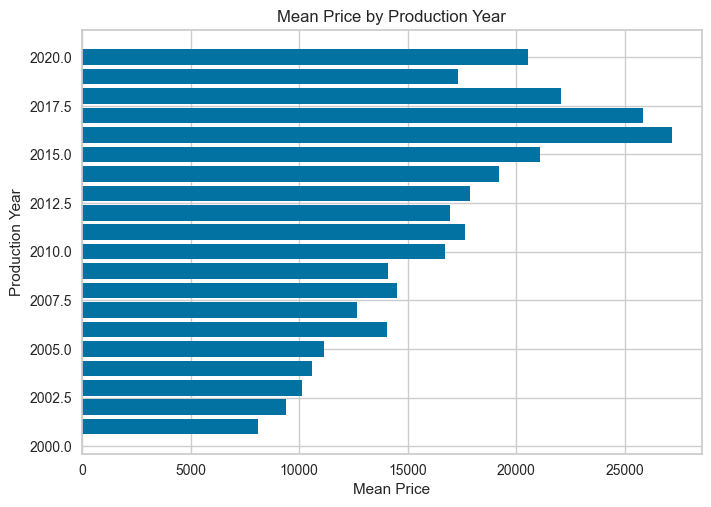

In [39]:
sales_df_train_sorted = sales_df_train.groupby('production_year')['price'].mean().reset_index().sort_values(by='production_year')

plt.barh(y=sales_df_train_sorted['production_year'], width=sales_df_train_sorted['price'])

plt.xlabel('Mean Price')
plt.ylabel('Production Year')
plt.title('Mean Price by Production Year')

plt.show()

In [40]:
mean_price_per_year_train = sales_df_train.groupby('production_year')['price'].mean().reset_index()
mean_price_per_year_train.set_index('production_year', inplace = True)

mean_price_per_year_train.to_dict()

{'price': {2001: 8126.425531914893,
  2002: 9388.9296875,
  2003: 10141.964788732394,
  2004: 10593.33082706767,
  2005: 11163.812154696132,
  2006: 14069.231884057972,
  2007: 12650.119815668202,
  2008: 14509.5140562249,
  2009: 14094.069204152249,
  2010: 16719.492176386913,
  2011: 17620.232620320854,
  2012: 16939.22859744991,
  2013: 17890.58742632613,
  2014: 19207.104672897196,
  2015: 21077.17232375979,
  2016: 27185.359108781126,
  2017: 25819.393548387096,
  2018: 22062.626666666667,
  2019: 17292.515873015873,
  2020: 20525.0}}

In [41]:
sales_df_train['avg_price_per_year'] = sales_df_train['production_year'].map(mean_price_per_year_train['price'])
sales_df_test['avg_price_per_year'] = sales_df_test['production_year'].map(mean_price_per_year_train['price'])

sales_df_train.head()

,levy,manufacturer,model,production_year,category,lether_interior,fuel_type,engine_size,gearbox_type,drive_wheels,doors,color,airbags,mileage_cut,price,avg_price_per_year
14087,1079,31,758,2018,0,1,1,2.0,0,0,4,2,12,3,6743,22062.626667
8362,1018,15,45,2011,0,1,1,3.0,0,0,4,1,12,2,6586,17620.232620
17171,707,4,19,2011,2,1,1,2.0,0,1,4,1,4,0,16894,17620.232620
6870,831,18,99,2017,0,1,2,1.6,0,1,4,0,4,1,40901,25819.393548
15913,687,4,117,2010,1,1,1,1.6,0,1,4,5,4,2,13877,16719.492176


In [42]:
sales_df_test.head()

,levy,manufacturer,model,production_year,category,lether_interior,fuel_type,engine_size,gearbox_type,drive_wheels,doors,color,airbags,mileage_cut,price,avg_price_per_year
18911,0,16,1351,2014,2,1,1,2.4,0,1,4,1,12,3,19130,19207.104673
4459,640,1,37,2013,2,1,2,2.0,0,1,4,2,4,3,9252,17890.587426
13572,530,12,28,2013,0,1,1,1.6,0,0,4,6,0,2,14113,17890.587426
12902,583,4,9,2011,2,1,1,1.6,0,1,4,5,4,0,18531,17620.232620
6064,642,4,84,2012,0,1,2,2.0,0,1,4,2,4,2,22947,16939.228597


## Average price per engine size

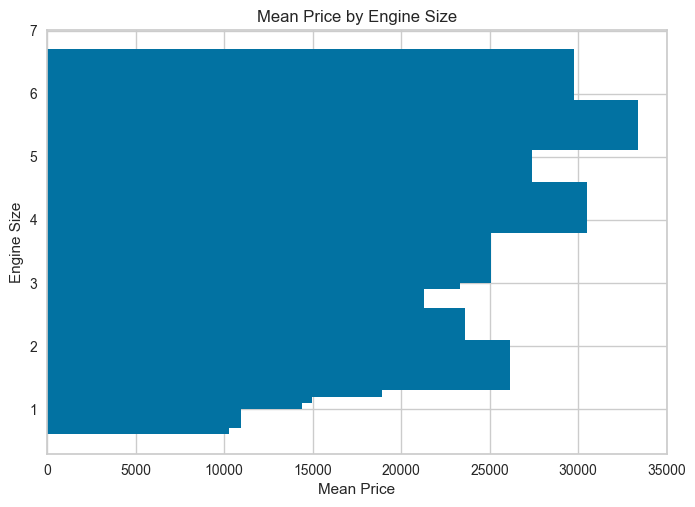

In [43]:
sales_df_train_sorted = sales_df_train.groupby('engine_size')['price'].mean().reset_index().sort_values(by='engine_size')

plt.barh(y=sales_df_train_sorted['engine_size'], width=sales_df_train_sorted['price'])

plt.xlabel('Mean Price')
plt.ylabel('Engine Size')
plt.title('Mean Price by Engine Size')

plt.show()

In [44]:
mean_price_per_year_train = sales_df_train.groupby('engine_size')['price'].mean().reset_index()
mean_price_per_year_train.set_index('engine_size', inplace = True)

mean_price_per_year_train.to_dict()

sales_df_train['avg_price_per_engine_size'] = sales_df_train['engine_size'].map(mean_price_per_year_train['price'])
sales_df_test['avg_price_per_engine_size'] = sales_df_test['engine_size'].map(mean_price_per_year_train['price'])

sales_df_train.head()

,levy,manufacturer,model,production_year,category,lether_interior,fuel_type,engine_size,gearbox_type,drive_wheels,doors,color,airbags,mileage_cut,price,avg_price_per_year,avg_price_per_engine_size
14087,1079,31,758,2018,0,1,1,2.0,0,0,4,2,12,3,6743,22062.626667,20717.454320
8362,1018,15,45,2011,0,1,1,3.0,0,0,4,1,12,2,6586,17620.232620,18971.279302
17171,707,4,19,2011,2,1,1,2.0,0,1,4,1,4,0,16894,17620.232620,20717.454320
6870,831,18,99,2017,0,1,2,1.6,0,1,4,0,4,1,40901,25819.393548,18924.820513
15913,687,4,117,2010,1,1,1,1.6,0,1,4,5,4,2,13877,16719.492176,18924.820513


In [45]:
sales_df_test.head()

,levy,manufacturer,model,production_year,category,lether_interior,fuel_type,engine_size,gearbox_type,drive_wheels,doors,color,airbags,mileage_cut,price,avg_price_per_year,avg_price_per_engine_size
18911,0,16,1351,2014,2,1,1,2.4,0,1,4,1,12,3,19130,19207.104673,16600.154472
4459,640,1,37,2013,2,1,2,2.0,0,1,4,2,4,3,9252,17890.587426,20717.454320
13572,530,12,28,2013,0,1,1,1.6,0,0,4,6,0,2,14113,17890.587426,18924.820513
12902,583,4,9,2011,2,1,1,1.6,0,1,4,5,4,0,18531,17620.232620,18924.820513
6064,642,4,84,2012,0,1,2,2.0,0,1,4,2,4,2,22947,16939.228597,20717.454320


In [46]:
X_train = sales_df_train.drop(['production_year', 'engine_size', 'price'], axis = 1)

In [47]:
sales_df_test.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2855 entries, 18911 to 9746
Data columns (total 17 columns):
 #   Column                     Non-Null Count  Dtype   
---  ------                     --------------  -----   
 0   levy                       2855 non-null   int64   
 1   manufacturer               2855 non-null   int64   
 2   model                      2855 non-null   int64   
 3   production_year            2855 non-null   int64   
 4   category                   2855 non-null   int64   
 5   lether_interior            2855 non-null   int64   
 6   fuel_type                  2855 non-null   int64   
 7   engine_size                2855 non-null   float64 
 8   gearbox_type               2855 non-null   int64   
 9   drive_wheels               2855 non-null   int64   
 10  doors                      2855 non-null   int64   
 11  color                      2855 non-null   int64   
 12  airbags                    2855 non-null   int64   
 13  mileage_cut                28

In [48]:
sales_df_test.dropna(inplace = True)
sales_df_test.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2851 entries, 18911 to 9746
Data columns (total 17 columns):
 #   Column                     Non-Null Count  Dtype   
---  ------                     --------------  -----   
 0   levy                       2851 non-null   int64   
 1   manufacturer               2851 non-null   int64   
 2   model                      2851 non-null   int64   
 3   production_year            2851 non-null   int64   
 4   category                   2851 non-null   int64   
 5   lether_interior            2851 non-null   int64   
 6   fuel_type                  2851 non-null   int64   
 7   engine_size                2851 non-null   float64 
 8   gearbox_type               2851 non-null   int64   
 9   drive_wheels               2851 non-null   int64   
 10  doors                      2851 non-null   int64   
 11  color                      2851 non-null   int64   
 12  airbags                    2851 non-null   int64   
 13  mileage_cut                28

In [49]:
X_test = sales_df_test.drop(['production_year', 'engine_size', 'price'], axis = 1)
X_train.head()

,levy,manufacturer,model,category,lether_interior,fuel_type,gearbox_type,drive_wheels,doors,color,airbags,mileage_cut,avg_price_per_year,avg_price_per_engine_size
14087,1079,31,758,0,1,1,0,0,4,2,12,3,22062.626667,20717.454320
8362,1018,15,45,0,1,1,0,0,4,1,12,2,17620.232620,18971.279302
17171,707,4,19,2,1,1,0,1,4,1,4,0,17620.232620,20717.454320
6870,831,18,99,0,1,2,0,1,4,0,4,1,25819.393548,18924.820513
15913,687,4,117,1,1,1,0,1,4,5,4,2,16719.492176,18924.820513


In [50]:
y_test = sales_df_test['price']

In [51]:
reg = ExtraTreesRegressor(n_estimators=100, random_state=0, n_jobs=-1).fit(X_train, y_train)

pred = reg.predict(X_test)
print(reg.score(X_test, y_test))
print("mae: ",mean_absolute_error(pred,y_test))
print("r2: ",r2_score(pred,y_test))

0.7321266825945647
mae:  3621.8211561538546
r2:  0.6647753622480331


Again around the same results

# Grid Search

Let's try to find the best parameters

In [52]:
param_grid = {
    'n_estimators': [50, 100, 150],
    'max_depth': [None, 10, 20],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4],
    'max_features': ['auto', 'sqrt', 'log2']
}

reg = ExtraTreesRegressor(random_state=0, n_jobs=-1)

grid_search = GridSearchCV(reg, param_grid, cv=5, scoring='neg_mean_squared_error', n_jobs=-1)

grid_search.fit(X_train, y_train)

print("Best Parameters: ", grid_search.best_params_)

best_reg = grid_search.best_estimator_

Best Parameters:  {'max_depth': 20, 'max_features': 'auto', 'min_samples_leaf': 1, 'min_samples_split': 5, 'n_estimators': 150}


In [53]:
best_reg.score(X_test, y_test)

0.7456133064151647

In [54]:
best_reg = ExtraTreesRegressor(
    n_estimators=grid_search.best_params_['n_estimators'],
    max_depth=grid_search.best_params_['max_depth'],
    min_samples_split=grid_search.best_params_['min_samples_split'],
    min_samples_leaf=grid_search.best_params_['min_samples_leaf'],
    max_features=grid_search.best_params_['max_features'],
    random_state=0,
    n_jobs=-1
)

best_reg.fit(X_train, y_train)
predictions = best_reg.predict(X_test)
best_reg.score(X_test, y_test)

0.7456133064151647

In [55]:
print(best_reg.predict(X_test))
y_test

[24376.68166667 16392.9496059  13103.26290528 ... 27551.94107265
 38120.21040747  2383.15679384]


18911    19130
4459      9252
13572    14113
12902    18531
6064     22947
         ...  
15888    25089
18306     2038
11107    27174
8932     47810
9746      1882
Name: price, Length: 2851, dtype: int64

In [56]:
y_test

18911    19130
4459      9252
13572    14113
12902    18531
6064     22947
         ...  
15888    25089
18306     2038
11107    27174
8932     47810
9746      1882
Name: price, Length: 2851, dtype: int64

In [3]:
sales_df = pd.read_csv('../Datasets/car_price_prediction-preprocess.csv')

manufacturer_dict = {manufacturer: i for i, manufacturer in enumerate(sales_df['manufacturer'].unique())}
sales_df['manufacturer'] = sales_df['manufacturer'].map(manufacturer_dict)

sales_df['lether_interior'] = sales_df['lether_interior'].replace({'Yes': 1, 'No': 0})

fuel_type_dict = {fuel_type: i for i, fuel_type in enumerate(sales_df['fuel_type'].unique())}
sales_df['fuel_type'] = sales_df['fuel_type'].map(fuel_type_dict)

gearbox_type_dict = {gearbox_type: i for i, gearbox_type in enumerate(sales_df['gearbox_type'].unique())}
sales_df['gearbox_type'] = sales_df['gearbox_type'].map(gearbox_type_dict)

color_dict = {color: i for i, color in enumerate(sales_df['color'].unique())}
sales_df['color'] = sales_df['color'].map(color_dict)

category_dict = {category: i for i, category in enumerate(sales_df['category'].unique())}
sales_df['category'] = sales_df['category'].map(category_dict)

sales_df = sales_df.drop(['turbo', 'wheel', 'cylinders', 'drive_wheels'], axis = 1)

sales_df = sales_df[sales_df['price'] < 50000]
sales_df = sales_df[sales_df['price'] > 1000]
sales_df = sales_df[sales_df['levy'] < 2000]
sales_df = sales_df[sales_df['mileage'] < 200000]
sales_df = sales_df[sales_df['production_year'] > 2000]
sales_df = sales_df[sales_df['engine_size'] >= 1]

sales_df.head()

,price,levy,manufacturer,model,production_year,category,lether_interior,fuel_type,engine_size,mileage,gearbox_type,doors,color,airbags
0,13328,1399,0,RX 450,2010,0,1,0,3.5,186005,0,4,0,12
1,16621,1018,1,Equinox,2011,0,0,1,3.0,192000,1,4,1,8
3,3607,862,3,Escape,2011,0,1,0,2.5,168966,0,4,2,0
4,11726,446,2,FIT,2014,1,1,1,1.3,91901,0,4,0,4
5,39493,891,4,Santa FE,2016,0,1,2,2.0,160931,0,4,2,4


In [4]:
sales_df['model'].nunique()

1102

In [4]:
def model_cleaner(model):
    try:
        model = model.split(' ')
        return model[0]
    except :
        return model

In [6]:
sales_df['model'] = sales_df['model'].apply(lambda x : model_cleaner(x) )
sales_df['model'].nunique()

470

In [7]:
model_dict = {model: i for i, model in enumerate(sales_df['model'].unique())}
sales_df['model'] = sales_df['model'].map(model_dict)

In [9]:
X = sales_df.drop(['price'], axis = 1)
y = sales_df['price']

X_train, X_test, y_train, y_test = train_test_split(X, y, random_state=0)
reg_selected = ExtraTreesRegressor(n_estimators=100, random_state=0, n_jobs=-1).fit(X_train, y_train)

pred = reg_selected.predict(X_test)
print(reg_selected.score(X_test, y_test))
print("mae: ",mean_absolute_error(pred,y_test))
print("r2: ",r2_score(pred,y_test))

0.7727787136239412
mae:  3227.5786477678967
r2:  0.7126307955528237


In [43]:
'''path = '../Model/'
with open(f'{path}ETR_car_sales.pkl', 'wb') as file:
    pickle.dump(reg_selected, file)

X_train.to_pickle(f'{path}train_data.pkl')
y_train.to_pickle(f'{path}train_label.pkl')

X_test.to_pickle(f'{path}test_data.pkl')
y_test.to_pickle(f'{path}test_label.pkl')'''

In [84]:
sales_df['mileage_cut'] = pd.cut(sales_df['mileage'], 4, labels=['low','medium_low','medium_high','high'])
mileage_dict = {mileage: i for i, mileage in enumerate(sales_df['mileage_cut'].unique())}
sales_df['mileage_cut'] = sales_df['mileage_cut'].map(mileage_dict)
sales_df.drop(['mileage'], axis = 1 , inplace = True)

In [85]:
X = sales_df.drop(['price'], axis = 1)
y = sales_df['price']

X_train, X_test, y_train, y_test = train_test_split(X, y, random_state=0)
reg = ExtraTreesRegressor(n_estimators=100, random_state=0, n_jobs=-1).fit(X_train, y_train)

pred = reg.predict(X_test)
print(reg.score(X_test, y_test))
print("mae: ",mean_absolute_error(pred,y_test))
print("r2: ",r2_score(pred,y_test))

0.7432361869322279
mae:  3534.79484306036
r2:  0.6752340691489989


In [86]:
X = sales_df.drop(['price'], axis = 1)
y = sales_df['price']

X_train, X_test, y_train, y_test = train_test_split(X, y, random_state=0)

sales_df_train = pd.concat([X_train, y_train], axis = 1)
sales_df_test = pd.concat([X_test, y_test], axis = 1)

mean_price_per_year_train = sales_df_train.groupby('production_year')['price'].mean().reset_index()
mean_price_per_year_train.set_index('production_year', inplace = True)
mean_price_per_year_train.to_dict()

sales_df_train['avg_price_per_year'] = sales_df_train['production_year'].map(mean_price_per_year_train['price'])
sales_df_test['avg_price_per_year'] = sales_df_test['production_year'].map(mean_price_per_year_train['price'])

mean_price_per_year_train = sales_df_train.groupby('engine_size')['price'].mean().reset_index()
mean_price_per_year_train.set_index('engine_size', inplace = True)
mean_price_per_year_train.to_dict()

sales_df_train['avg_price_per_engine_size'] = sales_df_train['engine_size'].map(mean_price_per_year_train['price'])
sales_df_test['avg_price_per_engine_size'] = sales_df_test['engine_size'].map(mean_price_per_year_train['price'])

X_train = sales_df_train.drop(['production_year', 'engine_size', 'price'], axis = 1)
sales_df_test.dropna(inplace = True)
X_test = sales_df_test.drop(['production_year', 'engine_size', 'price'], axis = 1)
y_test = sales_df_test['price']

reg = ExtraTreesRegressor(n_estimators=100, random_state=0, n_jobs=-1).fit(X_train, y_train)

pred = reg.predict(X_test)
print(reg.score(X_test, y_test))
print("mae: ",mean_absolute_error(pred,y_test))
print("r2: ",r2_score(pred,y_test))

0.7360259300736747
mae:  3591.5453126348298
r2:  0.6641875374128445
